# Load the data

In [122]:
# import python packages
import pandas as pd
import pandas
#import statsmodels.formula.api as sm
from sklearn import metrics
from sklearn.cross_validation import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import numpy
# allow plots to appear directly in the notebook
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')
# fix random seed for reproducibility
plt.rcParams['figure.figsize'] = (15, 6)
%matplotlib inline

In [123]:
# fix random seed for reproducibility
# Download data from sklearn library
# Target = MEDV
# So will be 13 attribute and 1 target(MEDV)
seed = 7
numpy.random.seed(seed)
from sklearn.datasets import load_boston
Boston = load_boston()

In [124]:
Boston.keys()

['data', 'feature_names', 'DESCR', 'target']

In [125]:
Boston.data.shape

(506, 13)

In [126]:
Boston.feature_names

array(['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD',
       'TAX', 'PTRATIO', 'B', 'LSTAT'], 
      dtype='|S7')

In [127]:
boston = pd.DataFrame(Boston.data)
dataset = boston
boston.head(3)

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,0.006,18.0,2.31,0.0,0.538,6.575,65.2,4.090,1.0,296.0,15.3,396.90,4.98
1,0.027,0.0,7.07,0.0,0.469,6.421,78.9,4.967,2.0,242.0,17.8,396.90,9.14
2,0.027,0.0,7.07,0.0,0.469,7.185,61.1,4.967,2.0,242.0,17.8,392.83,4.03


In [128]:
print Boston.DESCR

Boston House Prices dataset

Notes
------
Data Set Characteristics:  

    :Number of Instances: 506 

    :Number of Attributes: 13 numeric/categorical predictive
    
    :Median Value (attribute 14) is usually the target

    :Attribute Information (in order):
        - CRIM     per capita crime rate by town
        - ZN       proportion of residential land zoned for lots over 25,000 sq.ft.
        - INDUS    proportion of non-retail business acres per town
        - CHAS     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
        - NOX      nitric oxides concentration (parts per 10 million)
        - RM       average number of rooms per dwelling
        - AGE      proportion of owner-occupied units built prior to 1940
        - DIS      weighted distances to five Boston employment centres
        - RAD      index of accessibility to radial highways
        - TAX      full-value property-tax rate per $10,000
        - PTRATIO  pupil-teacher ratio by town
      

Attribute Information:

    1. CRIM      per capita crime rate by town
    2. ZN        proportion of residential land zoned for lots over 
                 25,000 sq.ft.
    3. INDUS     proportion of non-retail business acres per town
    4. CHAS      Charles River dummy variable (= 1 if tract bounds 
                 river; 0 otherwise)
    5. NOX       nitric oxides concentration (parts per 10 million)
    6. RM        average number of rooms per dwelling
    7. AGE       proportion of owner-occupied units built prior to 1940
    8. DIS       weighted distances to five Boston employment centres
    9. RAD       index of accessibility to radial highways
    10. TAX      full-value property-tax rate per $10,000
    11. PTRATIO  pupil-teacher ratio by town
    12. B        1000(Bk - 0.63)^2 where Bk is the proportion of blacks 
                 by town
    13. LSTAT    % lower status of the population
    14. MEDV  (Target)   Median value of owner-occupied homes in $1000's

In [129]:
dataset = load_boston()
df = pd.DataFrame(dataset.data, columns=dataset.feature_names)
df['target'] = dataset.target
data = df

In [130]:
data.head(3)

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
0,0.006,18.0,2.31,0.0,0.538,6.575,65.2,4.090,1.0,296.0,15.3,396.90,4.98,24.0
1,0.027,0.0,7.07,0.0,0.469,6.421,78.9,4.967,2.0,242.0,17.8,396.90,9.14,21.6
2,0.027,0.0,7.07,0.0,0.469,7.185,61.1,4.967,2.0,242.0,17.8,392.83,4.03,34.7


In [131]:
df.describe()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
count,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000,506.000
mean,3.594,11.364,11.137,0.069,0.555,6.285,68.575,3.795,9.549,408.237,18.456,356.674,12.653,22.533
std,8.597,23.322,6.860,0.254,0.116,0.703,28.149,2.106,8.707,168.537,2.165,91.295,7.141,9.197
min,0.006,0.000,0.460,0.000,0.385,3.561,2.900,1.130,1.000,187.000,12.600,0.320,1.730,5.000
25%,0.082,0.000,5.190,0.000,0.449,5.886,45.025,2.100,4.000,279.000,17.400,375.377,6.950,17.025
50%,0.257,0.000,9.690,0.000,0.538,6.208,77.500,3.207,5.000,330.000,19.050,391.440,11.360,21.200
75%,3.647,12.500,18.100,0.000,0.624,6.623,94.075,5.188,24.000,666.000,20.200,396.225,16.955,25.000
max,88.976,100.000,27.740,1.000,0.871,8.780,100.000,12.127,24.000,711.000,22.000,396.900,37.970,50.000


In [132]:
pd.isnull(df).any()

CRIM       False
ZN         False
INDUS      False
CHAS       False
NOX        False
RM         False
AGE        False
DIS        False
RAD        False
TAX        False
PTRATIO    False
B          False
LSTAT      False
target     False
dtype: bool

In [133]:
pd.isnull(df).sum()

CRIM       0
ZN         0
INDUS      0
CHAS       0
NOX        0
RM         0
AGE        0
DIS        0
RAD        0
TAX        0
PTRATIO    0
B          0
LSTAT      0
target     0
dtype: int64

In [134]:
shape = data.shape
print(shape)

(506, 14)


In [135]:
types = data.dtypes
print(types)

CRIM       float64
ZN         float64
INDUS      float64
CHAS       float64
NOX        float64
RM         float64
AGE        float64
DIS        float64
RAD        float64
TAX        float64
PTRATIO    float64
B          float64
LSTAT      float64
target     float64
dtype: object


In [136]:
data.tail()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
501,0.063,0.0,11.93,0.0,0.573,6.593,69.1,2.479,1.0,273.0,21.0,391.99,9.67,22.4
502,0.045,0.0,11.93,0.0,0.573,6.120,76.7,2.288,1.0,273.0,21.0,396.90,9.08,20.6
503,0.061,0.0,11.93,0.0,0.573,6.976,91.0,2.167,1.0,273.0,21.0,396.90,5.64,23.9
504,0.110,0.0,11.93,0.0,0.573,6.794,89.3,2.389,1.0,273.0,21.0,393.45,6.48,22.0
505,0.047,0.0,11.93,0.0,0.573,6.030,80.8,2.505,1.0,273.0,21.0,396.90,7.88,11.9


In [137]:
pandas.set_option('display.width', 100)
pandas.set_option('precision', 3)
description = data.describe()
print(description)

          CRIM       ZN    INDUS     CHAS      NOX       RM      AGE      DIS      RAD      TAX  \
count  506.000  506.000  506.000  506.000  506.000  506.000  506.000  506.000  506.000  506.000   
mean     3.594   11.364   11.137    0.069    0.555    6.285   68.575    3.795    9.549  408.237   
std      8.597   23.322    6.860    0.254    0.116    0.703   28.149    2.106    8.707  168.537   
min      0.006    0.000    0.460    0.000    0.385    3.561    2.900    1.130    1.000  187.000   
25%      0.082    0.000    5.190    0.000    0.449    5.886   45.025    2.100    4.000  279.000   
50%      0.257    0.000    9.690    0.000    0.538    6.208   77.500    3.207    5.000  330.000   
75%      3.647   12.500   18.100    0.000    0.624    6.623   94.075    5.188   24.000  666.000   
max     88.976  100.000   27.740    1.000    0.871    8.780  100.000   12.127   24.000  711.000   

       PTRATIO        B    LSTAT   target  
count  506.000  506.000  506.000  506.000  
mean    18.456  356.

In [138]:
class_counts = data.groupby('target').size()
print(class_counts)

target
5.0      2
5.6      1
6.3      1
7.0      2
7.2      3
7.4      1
7.5      1
8.1      1
8.3      2
8.4      2
8.5      2
8.7      1
8.8      2
9.5      1
9.6      1
9.7      1
10.2     3
10.4     2
10.5     2
10.8     1
10.9     2
11.0     1
11.3     1
11.5     1
11.7     2
11.8     2
11.9     2
12.0     1
12.1     1
12.3     1
        ..
35.2     1
35.4     2
36.0     1
36.1     1
36.2     2
36.4     1
36.5     1
37.0     1
37.2     1
37.3     1
37.6     1
37.9     1
38.7     1
39.8     1
41.3     1
41.7     1
42.3     1
42.8     1
43.1     1
43.5     1
43.8     1
44.0     1
44.8     1
45.4     1
46.0     1
46.7     1
48.3     1
48.5     1
48.8     1
50.0    16
dtype: int64


In [139]:
skew = data.skew()
print(skew)

CRIM       5.238
ZN         2.226
INDUS      0.295
CHAS       3.406
NOX        0.729
RM         0.404
AGE       -0.599
DIS        1.012
RAD        1.005
TAX        0.670
PTRATIO   -0.802
B         -2.890
LSTAT      0.906
target     1.108
dtype: float64


## Corelation of the data
More Information in the following Link
http://www.statisticssolutions.com/correlation-pearson-kendall-spearman/

In [140]:
correlations = data.corr(method='pearson')
print(correlations)

          CRIM     ZN  INDUS   CHAS    NOX     RM    AGE    DIS    RAD    TAX  PTRATIO      B  \
CRIM     1.000 -0.199  0.404 -0.055  0.418 -0.220  0.351 -0.378  0.622  0.580    0.288 -0.377   
ZN      -0.199  1.000 -0.534 -0.043 -0.517  0.312 -0.570  0.664 -0.312 -0.315   -0.392  0.176   
INDUS    0.404 -0.534  1.000  0.063  0.764 -0.392  0.645 -0.708  0.595  0.721    0.383 -0.357   
CHAS    -0.055 -0.043  0.063  1.000  0.091  0.091  0.087 -0.099 -0.007 -0.036   -0.122  0.049   
NOX      0.418 -0.517  0.764  0.091  1.000 -0.302  0.731 -0.769  0.611  0.668    0.189 -0.380   
RM      -0.220  0.312 -0.392  0.091 -0.302  1.000 -0.240  0.205 -0.210 -0.292   -0.356  0.128   
AGE      0.351 -0.570  0.645  0.087  0.731 -0.240  1.000 -0.748  0.456  0.506    0.262 -0.274   
DIS     -0.378  0.664 -0.708 -0.099 -0.769  0.205 -0.748  1.000 -0.495 -0.534   -0.232  0.292   
RAD      0.622 -0.312  0.595 -0.007  0.611 -0.210  0.456 -0.495  1.000  0.910    0.465 -0.444   
TAX      0.580 -0.315  0.721 -

In [141]:
df.corr(method='pearson')

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
CRIM,1.000,-0.199,0.404,-0.055,0.418,-0.220,0.351,-0.378,0.622,0.580,0.288,-0.377,0.452,-0.386
ZN,-0.199,1.000,-0.534,-0.043,-0.517,0.312,-0.570,0.664,-0.312,-0.315,-0.392,0.176,-0.413,0.360
INDUS,0.404,-0.534,1.000,0.063,0.764,-0.392,0.645,-0.708,0.595,0.721,0.383,-0.357,0.604,-0.484
CHAS,-0.055,-0.043,0.063,1.000,0.091,0.091,0.087,-0.099,-0.007,-0.036,-0.122,0.049,-0.054,0.175
NOX,0.418,-0.517,0.764,0.091,1.000,-0.302,0.731,-0.769,0.611,0.668,0.189,-0.380,0.591,-0.427
RM,-0.220,0.312,-0.392,0.091,-0.302,1.000,-0.240,0.205,-0.210,-0.292,-0.356,0.128,-0.614,0.695
AGE,0.351,-0.570,0.645,0.087,0.731,-0.240,1.000,-0.748,0.456,0.506,0.262,-0.274,0.602,-0.377
DIS,-0.378,0.664,-0.708,-0.099,-0.769,0.205,-0.748,1.000,-0.495,-0.534,-0.232,0.292,-0.497,0.250
RAD,0.622,-0.312,0.595,-0.007,0.611,-0.210,0.456,-0.495,1.000,0.910,0.465,-0.444,0.489,-0.382
TAX,0.580,-0.315,0.721,-0.036,0.668,-0.292,0.506,-0.534,0.910,1.000,0.461,-0.442,0.544,-0.469


In [142]:
pearson = df.corr(method='pearson')
# assume target attr is the last, then remove corr with itself
corr_with_target = pearson.ix[-1][:-1]
# attributes sorted from the most predictive
predictivity = corr_with_target.sort(ascending=False)

/Users/salemameen/Library/Enthought/Canopy_64bit/User/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting


In [143]:
# correlation to the target or how much inflonce the taget 
corr_with_target[abs(corr_with_target).argsort()[::-1]]

LSTAT     -0.738
RM         0.695
PTRATIO   -0.508
INDUS     -0.484
TAX       -0.469
NOX       -0.427
CRIM      -0.386
RAD       -0.382
AGE       -0.377
ZN         0.360
B          0.333
DIS        0.250
CHAS       0.175
Name: target, dtype: float64

In [144]:
attrs = pearson.iloc[:-1,:-1] # all except target
# only important correlations and not auto-correlations
threshold = 0.5
# {('LSTAT', 'TAX'): 0.543993, ('INDUS', 'RAD'): 0.595129, ...
important_corrs = (attrs[abs(attrs) > threshold][attrs != 1.0]) \
    .unstack().dropna().to_dict()
#     attribute pair  correlation
# 0     (AGE, INDUS)     0.644779
# 1     (INDUS, RAD)     0.595129
# ...
unique_important_corrs = pd.DataFrame(
    list(set([(tuple(sorted(key)), important_corrs[key]) \
    for key in important_corrs])), columns=['attribute pair', 'correlation'])
# sorted by absolute value
unique_important_corrs = unique_important_corrs.ix[
    abs(unique_important_corrs['correlation']).argsort()[::-1]]

In [145]:
unique_important_corrs

,attribute pair,correlation
8,"(RAD, TAX)",0.910
4,"(DIS, NOX)",-0.769
16,"(INDUS, NOX)",0.764
3,"(AGE, DIS)",-0.748
1,"(AGE, NOX)",0.731
5,"(INDUS, TAX)",0.721
15,"(DIS, INDUS)",-0.708
14,"(NOX, TAX)",0.668
21,"(DIS, ZN)",0.664
12,"(AGE, INDUS)",0.645


In [146]:
%timeit df.corr(method='pearson')

1000 loops, best of 3: 382 µs per loop


In [147]:
df.corr(method='spearman')

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
CRIM,1.000,-0.572,0.735,0.042,0.820,-0.311,0.704,-0.744,0.726,0.728,0.464,-0.358,0.633,-0.557
ZN,-0.572,1.000,-0.643,-0.042,-0.635,0.361,-0.544,0.615,-0.279,-0.371,-0.448,0.163,-0.490,0.438
INDUS,0.735,-0.643,1.000,0.090,0.791,-0.415,0.679,-0.757,0.456,0.664,0.434,-0.286,0.639,-0.578
CHAS,0.042,-0.042,0.090,1.000,0.068,0.059,0.068,-0.080,0.025,-0.044,-0.136,-0.040,-0.051,0.141
NOX,0.820,-0.635,0.791,0.068,1.000,-0.310,0.795,-0.880,0.586,0.650,0.391,-0.297,0.637,-0.563
RM,-0.311,0.361,-0.415,0.059,-0.310,1.000,-0.278,0.263,-0.107,-0.272,-0.313,0.054,-0.641,0.634
AGE,0.704,-0.544,0.679,0.068,0.795,-0.278,1.000,-0.802,0.418,0.526,0.355,-0.228,0.657,-0.548
DIS,-0.744,0.615,-0.757,-0.080,-0.880,0.263,-0.802,1.000,-0.496,-0.574,-0.322,0.250,-0.564,0.446
RAD,0.726,-0.279,0.456,0.025,0.586,-0.107,0.418,-0.496,1.000,0.705,0.318,-0.283,0.394,-0.347
TAX,0.728,-0.371,0.664,-0.044,0.650,-0.272,0.526,-0.574,0.705,1.000,0.453,-0.330,0.534,-0.562


In [148]:
pearson = df.corr(method='spearman')
# assume target attr is the last, then remove corr with itself
corr_with_target = pearson.ix[-1][:-1]
# attributes sorted from the most predictive
predictivity = corr_with_target.sort(ascending=False)

/Users/salemameen/Library/Enthought/Canopy_64bit/User/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting


In [149]:
corr_with_target[abs(corr_with_target).argsort()[::-1]]

LSTAT     -0.853
RM         0.634
INDUS     -0.578
NOX       -0.563
TAX       -0.562
CRIM      -0.557
PTRATIO   -0.556
AGE       -0.548
DIS        0.446
ZN         0.438
RAD       -0.347
B          0.186
CHAS       0.141
Name: target, dtype: float64

In [150]:
attrs = pearson.iloc[:-1,:-1] # all except target
# only important correlations and not auto-correlations
threshold = 0.5
# {('LSTAT', 'TAX'): 0.543993, ('INDUS', 'RAD'): 0.595129, ...
important_corrs = (attrs[abs(attrs) > threshold][attrs != 1.0]) \
    .unstack().dropna().to_dict()
#     attribute pair  correlation
# 0     (AGE, INDUS)     0.644779
# 1     (INDUS, RAD)     0.595129
# ...
unique_important_corrs = pd.DataFrame(
    list(set([(tuple(sorted(key)), important_corrs[key]) \
    for key in important_corrs])), columns=['attribute pair', 'correlation'])
# sorted by absolute value
unique_important_corrs = unique_important_corrs.ix[
    abs(unique_important_corrs['correlation']).argsort()[::-1]]

In [151]:
# correlations between attribute pairs
unique_important_corrs

,attribute pair,correlation
21,"(DIS, NOX)",-0.880
8,"(CRIM, NOX)",0.820
10,"(AGE, DIS)",-0.802
19,"(AGE, NOX)",0.795
29,"(INDUS, NOX)",0.791
26,"(DIS, INDUS)",-0.757
17,"(CRIM, DIS)",-0.744
12,"(CRIM, INDUS)",0.735
6,"(CRIM, TAX)",0.728
22,"(CRIM, RAD)",0.726


In [152]:
%timeit df.corr(method='spearman')

100 loops, best of 3: 6.8 ms per loop


In [153]:
df.corr(method='kendall')

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
CRIM,1.000,-0.462,0.521,0.035,0.602,-0.213,0.497,-0.539,0.563,0.544,0.313,-0.262,0.453,-0.402
ZN,-0.462,1.000,-0.535,-0.039,-0.511,0.278,-0.429,0.479,-0.235,-0.290,-0.362,0.128,-0.387,0.340
INDUS,0.521,-0.535,1.000,0.076,0.612,-0.291,0.489,-0.565,0.354,0.483,0.337,-0.192,0.466,-0.418
CHAS,0.035,-0.039,0.076,1.000,0.056,0.048,0.056,-0.066,0.022,-0.038,-0.116,-0.033,-0.041,0.115
NOX,0.602,-0.511,0.612,0.056,1.000,-0.216,0.590,-0.684,0.435,0.453,0.279,-0.202,0.452,-0.395
RM,-0.213,0.278,-0.291,0.048,-0.216,1.000,-0.188,0.180,-0.077,-0.191,-0.223,0.033,-0.468,0.483
AGE,0.497,-0.429,0.489,0.056,0.590,-0.188,1.000,-0.610,0.306,0.360,0.252,-0.154,0.485,-0.388
DIS,-0.539,0.479,-0.565,-0.066,-0.684,0.180,-0.610,1.000,-0.362,-0.382,-0.223,0.169,-0.409,0.313
RAD,0.563,-0.235,0.354,0.022,0.435,-0.077,0.306,-0.362,1.000,0.558,0.252,-0.214,0.288,-0.248
TAX,0.544,-0.290,0.483,-0.038,0.453,-0.191,0.360,-0.382,0.558,1.000,0.288,-0.242,0.384,-0.415


In [154]:
pearson = df.corr(method='kendall')
# assume target attr is the last, then remove corr with itself
corr_with_target = pearson.ix[-1][:-1]
# attributes sorted from the most predictive
predictivity = corr_with_target.sort(ascending=False)

/Users/salemameen/Library/Enthought/Canopy_64bit/User/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting


In [155]:
corr_with_target[abs(corr_with_target).argsort()[::-1]]

LSTAT     -0.669
RM         0.483
INDUS     -0.418
TAX       -0.415
CRIM      -0.402
PTRATIO   -0.399
NOX       -0.395
AGE       -0.388
ZN         0.340
DIS        0.313
RAD       -0.248
B          0.127
CHAS       0.115
Name: target, dtype: float64

In [156]:
attrs = pearson.iloc[:-1,:-1] # all except target
# only important correlations and not auto-correlations
threshold = 0.5
# {('LSTAT', 'TAX'): 0.543993, ('INDUS', 'RAD'): 0.595129, ...
important_corrs = (attrs[abs(attrs) > threshold][attrs != 1.0]) \
    .unstack().dropna().to_dict()
#     attribute pair  correlation
# 0     (AGE, INDUS)     0.644779
# 1     (INDUS, RAD)     0.595129
# ...
unique_important_corrs = pd.DataFrame(
    list(set([(tuple(sorted(key)), important_corrs[key]) \
    for key in important_corrs])), columns=['attribute pair', 'correlation'])
# sorted by absolute value
unique_important_corrs = unique_important_corrs.ix[
    abs(unique_important_corrs['correlation']).argsort()[::-1]]

In [157]:
unique_important_corrs

,attribute pair,correlation
6,"(DIS, NOX)",-0.684
12,"(INDUS, NOX)",0.612
11,"(AGE, DIS)",-0.610
4,"(CRIM, NOX)",0.602
8,"(AGE, NOX)",0.590
0,"(DIS, INDUS)",-0.565
5,"(CRIM, RAD)",0.563
7,"(RAD, TAX)",0.558
1,"(CRIM, TAX)",0.544
9,"(CRIM, DIS)",-0.539


In [158]:
%timeit df.corr(method='kendall')

1 loop, best of 3: 664 ms per loop


# Visulize the data

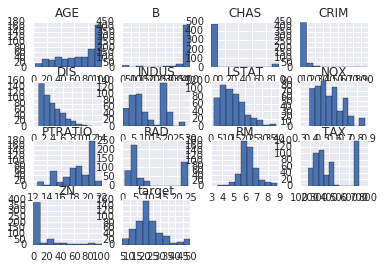

In [159]:
data.hist()
plt.rcParams['figure.figsize'] = (20, 15)
plt.show()

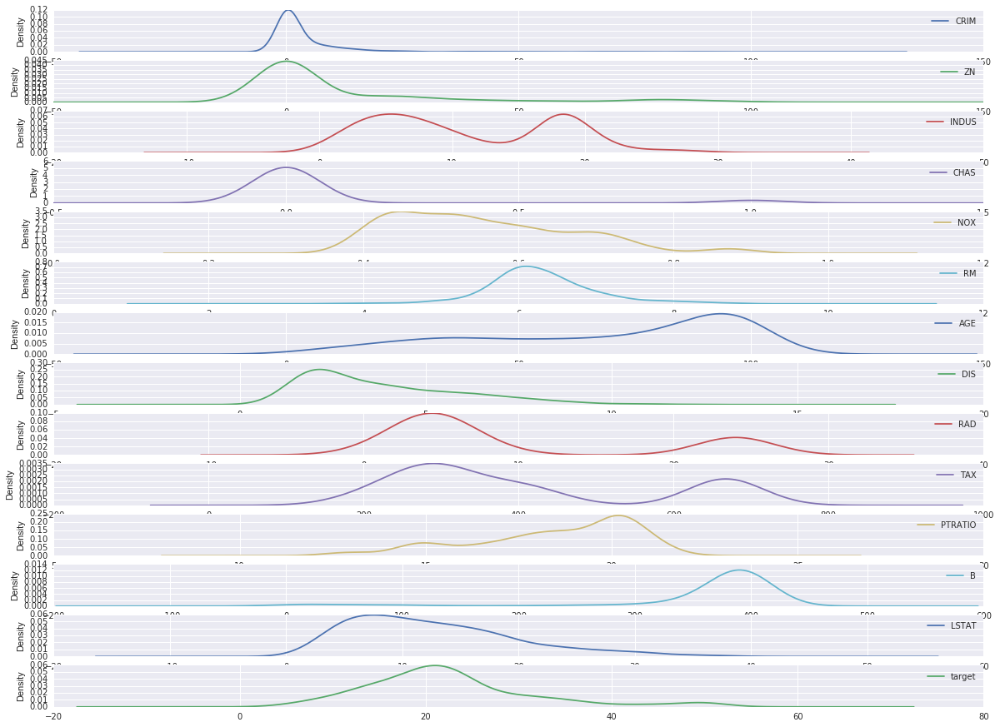

In [160]:
data.plot(kind='density', subplots=True,  sharex=False)
plt.show()

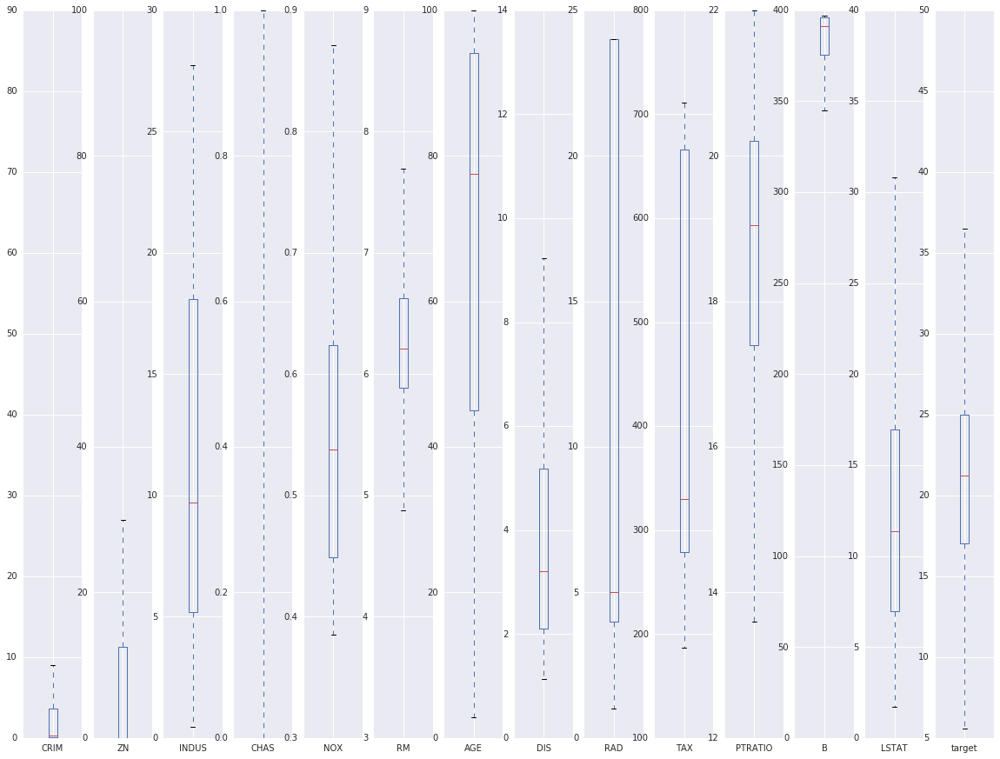

In [161]:
data.plot(kind='box', subplots=True,  sharex=False, sharey=False)
plt.show()

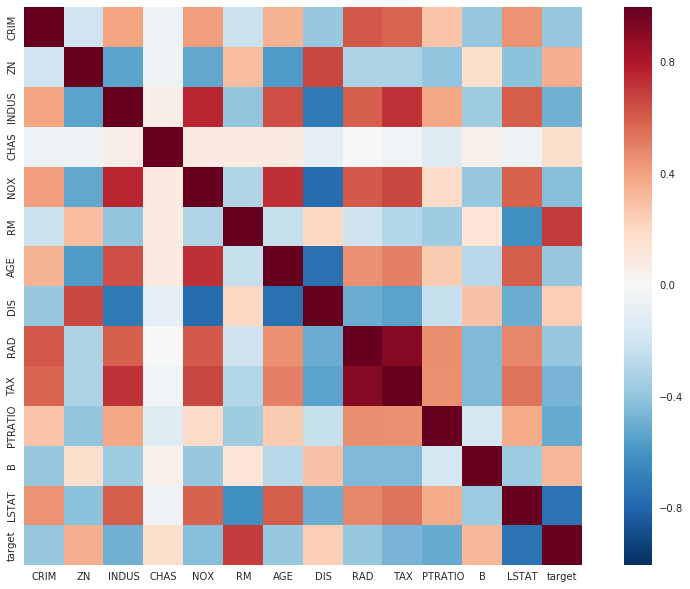

In [162]:
# Encode the categorical features as numbers
import seaborn as sns
def number_encode_features(df):
    result = df.copy()
    encoders = {}
    for column in result.columns:
        if result.dtypes[column] == np.object:
            encoders[column] = preprocessing.LabelEncoder()
            result[column] = encoders[column].fit_transform(result[column])
    return result, encoders

# Calculate the correlation and plot it
plt.rcParams['figure.figsize'] = (15, 10)
encoded_data, _ = number_encode_features(data)
sns.heatmap(encoded_data.corr(), square=True)
plt.show()

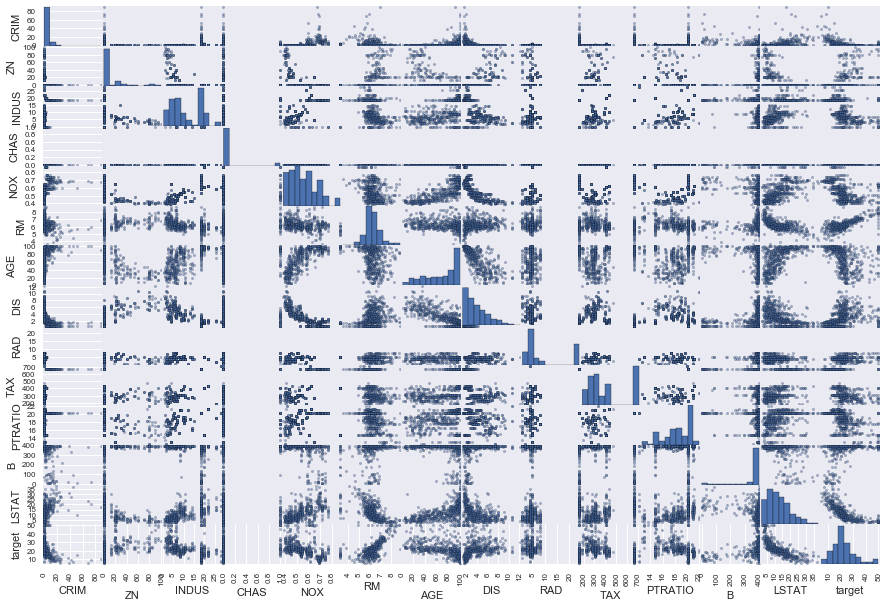

In [163]:
from pandas.tools.plotting import scatter_matrix
scatter_matrix(data)
plt.show()

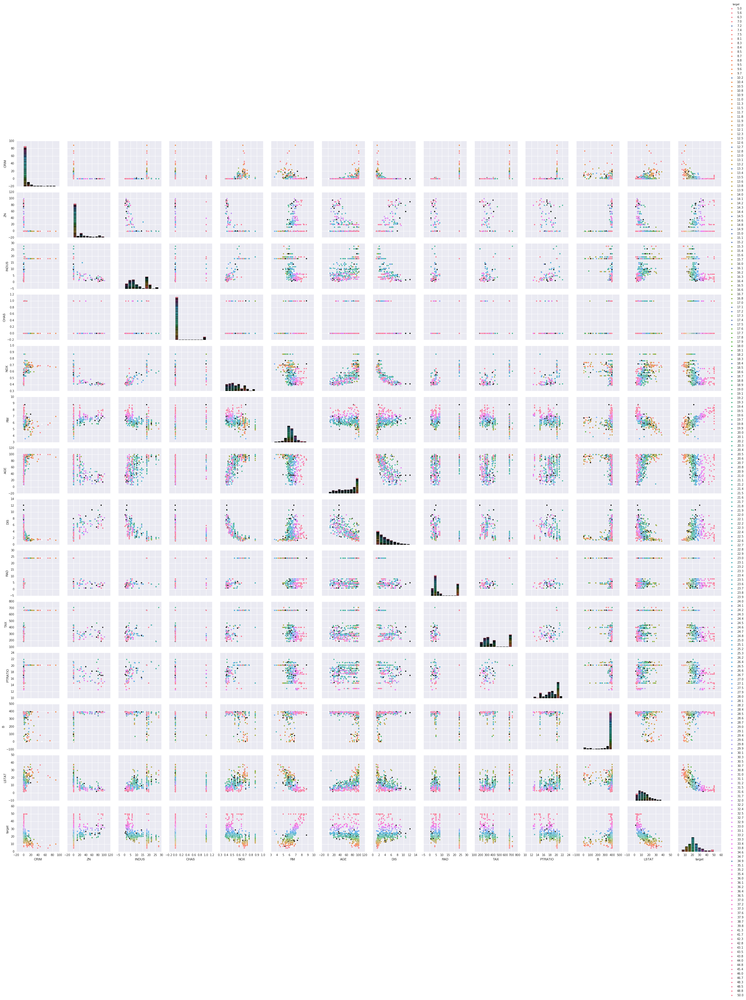

In [164]:
import seaborn as sns
sns.pairplot(data, hue='target')

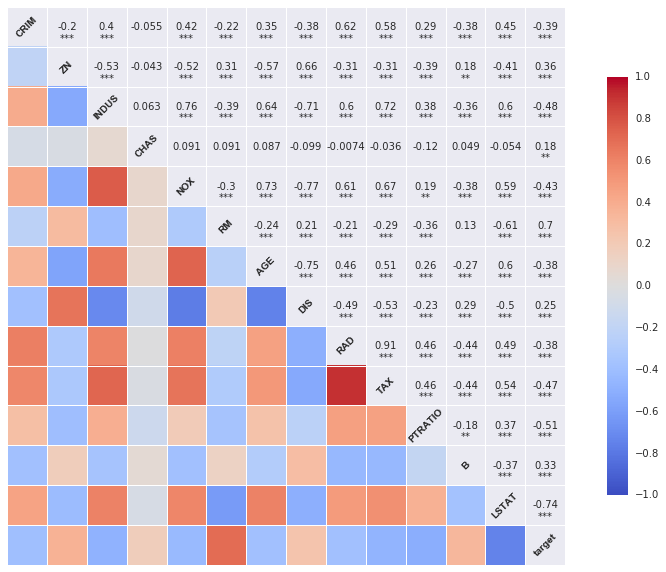

In [165]:
sns.corrplot(df) # compute and plot the pair-wise correlations
# save to file, remove the big white borders
plt.savefig('attribute_correlations.png', tight_layout=True)

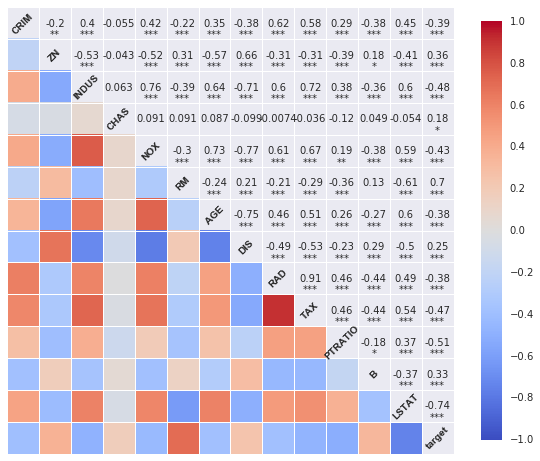

In [166]:
# make a plot of specified dimension (in inches), just a 1x1 subplot
fig, ax = plt.subplots(figsize=(10, 10))
# pass the axis to draw on
sns.corrplot(df, ax=ax)

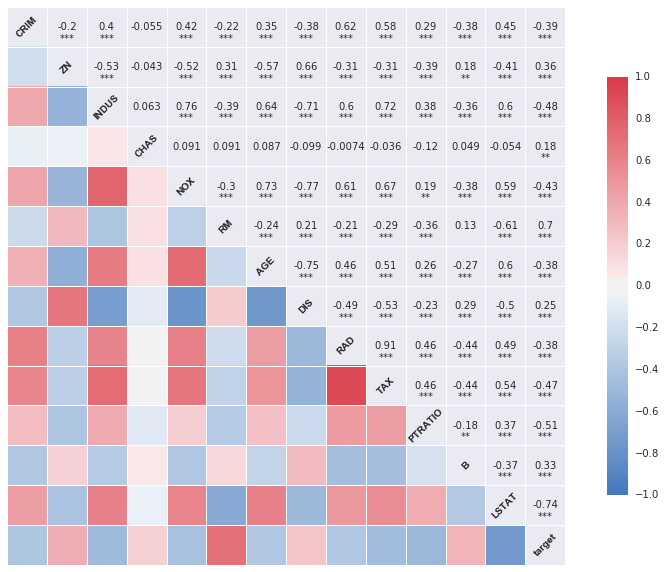

In [167]:
# red-blue (hues 250 and 10, just 3 colors) diverging pallete with white center
sns.corrplot(df, cmap=sns.diverging_palette(250, 10, n=3, as_cmap=True))

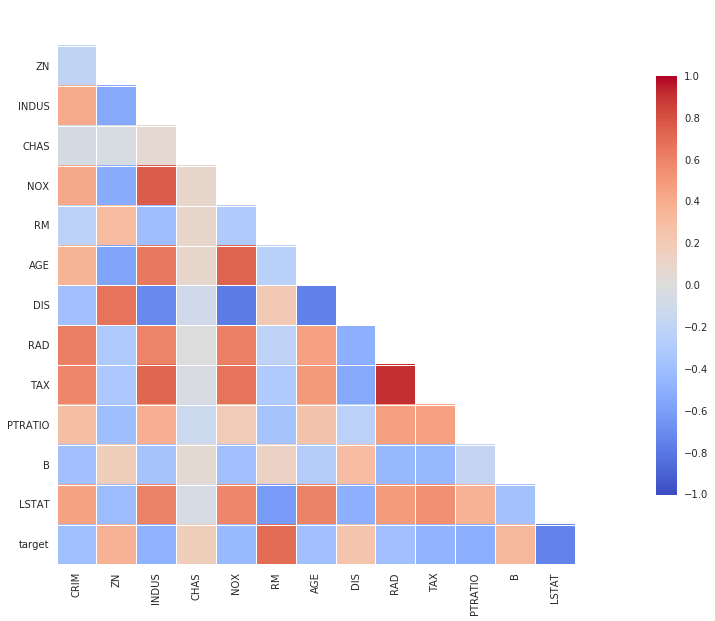

In [168]:
sns.corrplot(df, annot=False, sig_stars=False, diag_names=False)

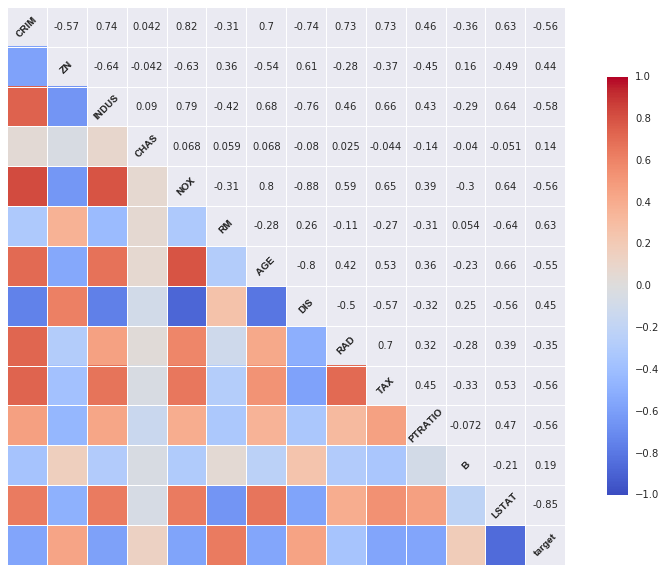

In [169]:
sns.corrplot(df,method='spearman') # compute and plot the pair-wise correlations
# save to file, remove the big white borders
plt.savefig('attribute_correlations_spearman.png', tight_layout=True)

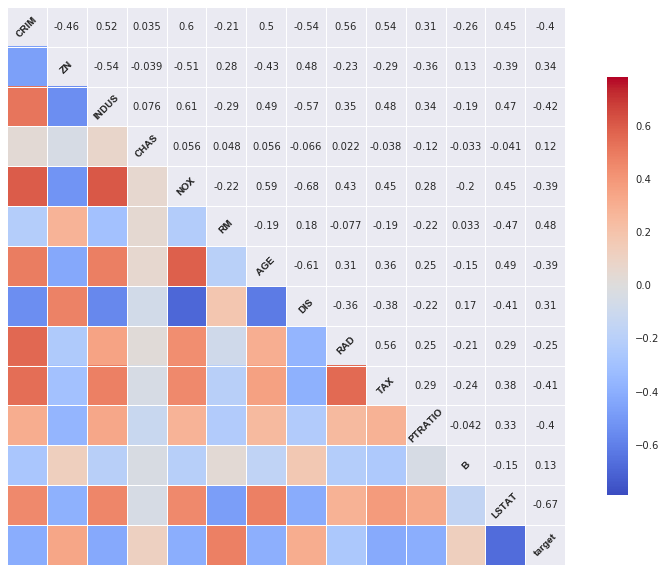

In [170]:
sns.corrplot(df,method='kendall') # compute and plot the pair-wise correlations
# save to file, remove the big white borders
plt.savefig('attribute_correlations_kendall.png', tight_layout=True)

### Attribute histograms

(array([  21.,   55.,   82.,  154.,   84.,   41.,   30.,    8.,   10.,   21.]),
 array([  5. ,   9.5,  14. ,  18.5,  23. ,  27.5,  32. ,  36.5,  41. ,
         45.5,  50. ]),
 <a list of 10 Patch objects>)

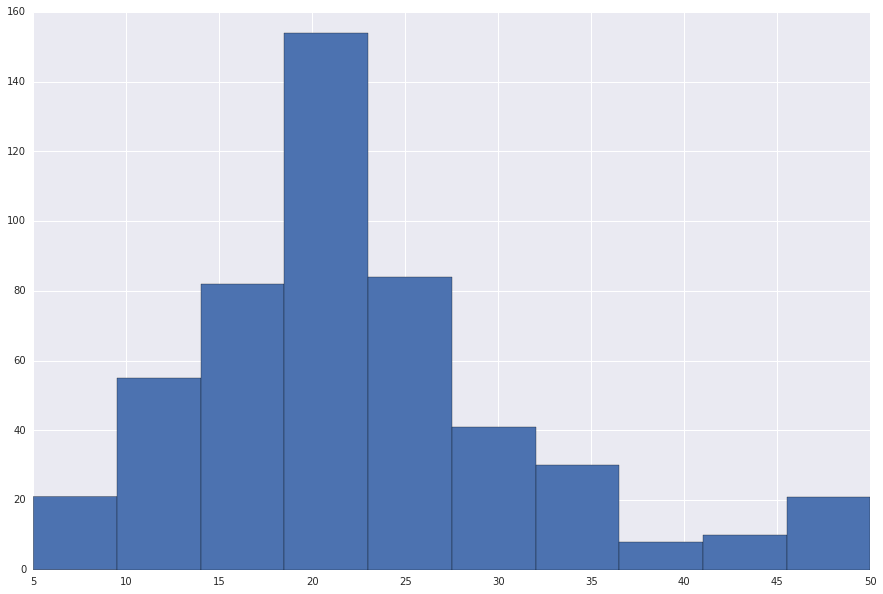

In [171]:
import matplotlib.pyplot as plt
attr = df['target']
plt.hist(attr)

(array([  3.,   1.,   7.,   7.,   3.,   6.,   8.,  10.,   8.,  23.,  15.,
         19.,  12.,  18.,  18.,  28.,  36.,  29.,  33.,  28.,  32.,  26.,
         15.,   4.,   7.,   9.,  11.,   9.,   5.,   7.,   6.,   9.,   2.,
          8.,   5.,   4.,   2.,   1.,   1.,   0.,   2.,   1.,   3.,   2.,
          2.,   1.,   1.,   0.,   3.,  16.]),
 array([  5. ,   5.9,   6.8,   7.7,   8.6,   9.5,  10.4,  11.3,  12.2,
         13.1,  14. ,  14.9,  15.8,  16.7,  17.6,  18.5,  19.4,  20.3,
         21.2,  22.1,  23. ,  23.9,  24.8,  25.7,  26.6,  27.5,  28.4,
         29.3,  30.2,  31.1,  32. ,  32.9,  33.8,  34.7,  35.6,  36.5,
         37.4,  38.3,  39.2,  40.1,  41. ,  41.9,  42.8,  43.7,  44.6,
         45.5,  46.4,  47.3,  48.2,  49.1,  50. ]),
 <a list of 50 Patch objects>)

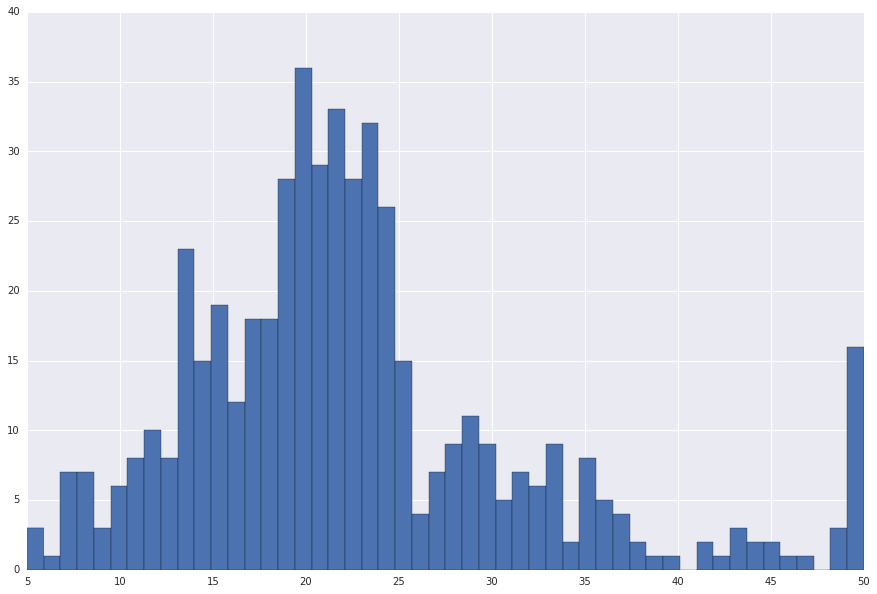

In [172]:
plt.hist(attr, bins=50)

In [174]:
#sns.displot(attr)

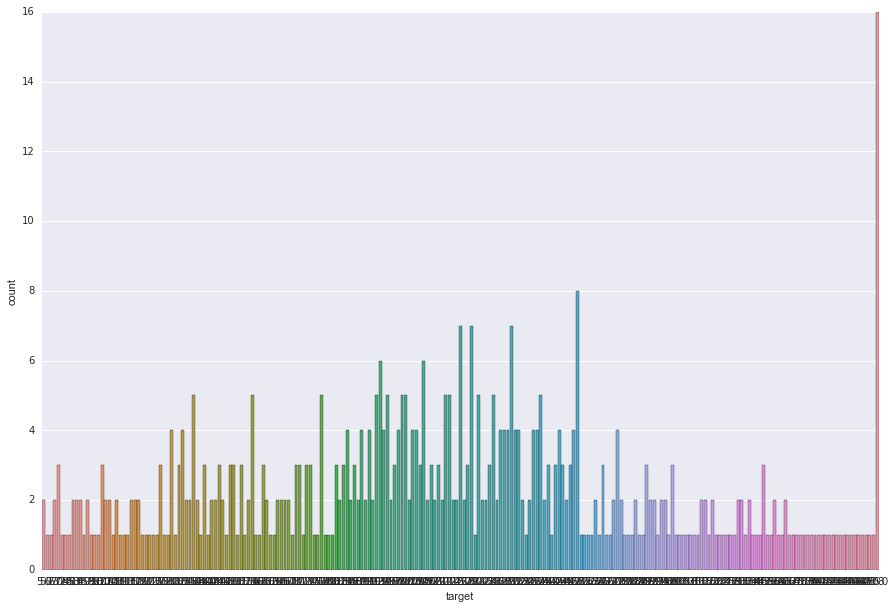

In [175]:
sns.countplot(attr)

AttributeError: 'Series' object has no attribute 'items'

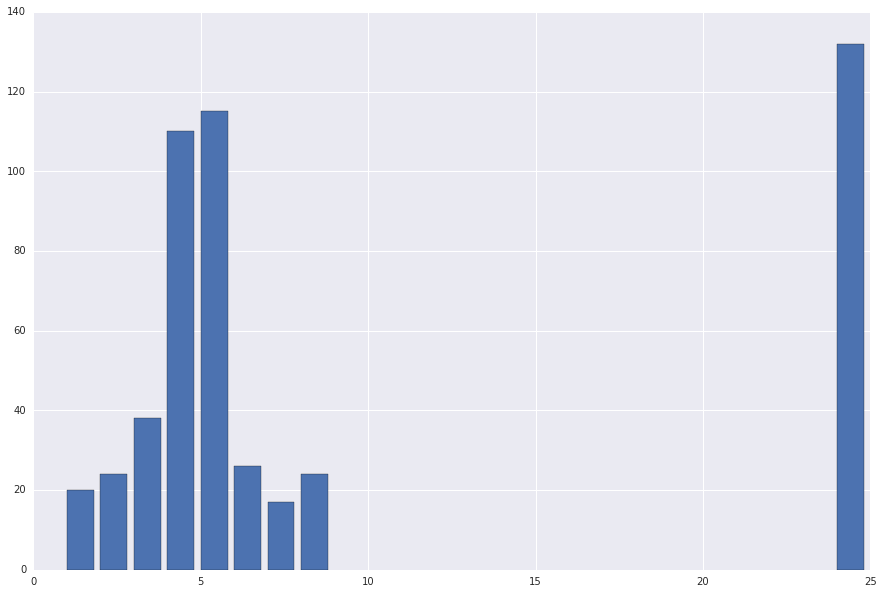

In [178]:
cat_attr = df['RAD']
h = cat_attr.value_counts()
values, counts = h.index, h
plt.bar(values, counts)
# or more compactly:
plt.bar(*list(zip(*cat_attr.value_counts().items())))

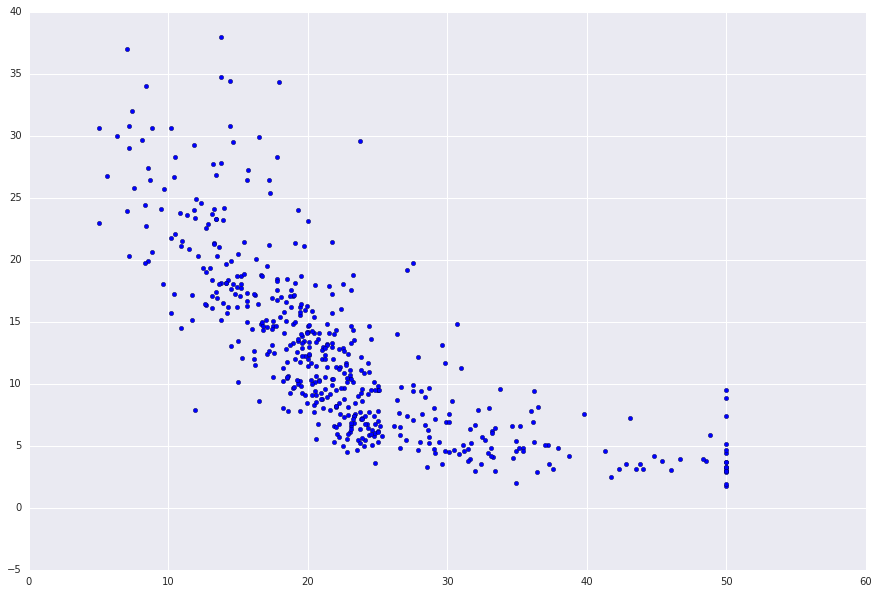

In [179]:
plt.scatter(df['target'], df['LSTAT'])

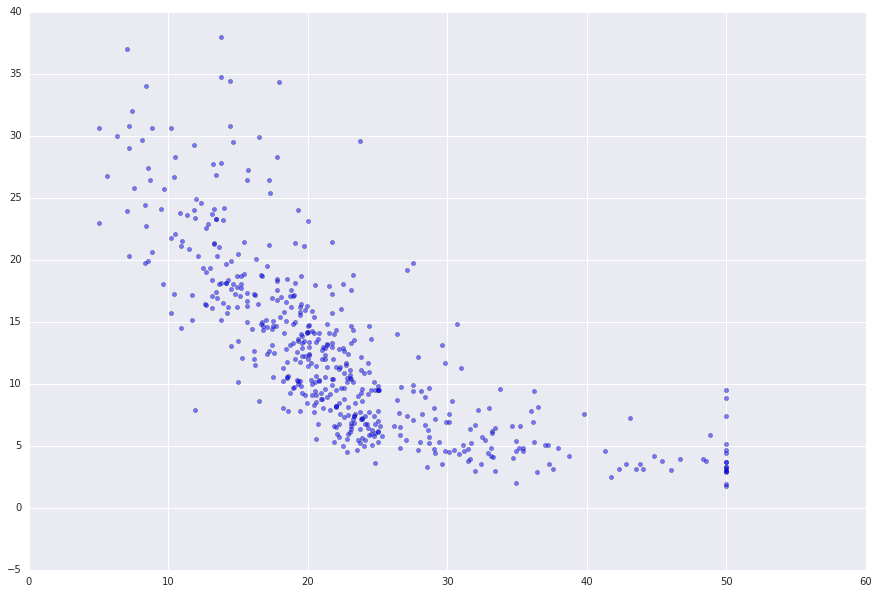

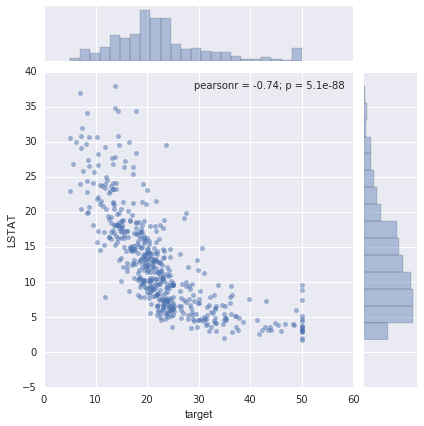

In [180]:
x, y = df['target'], df['LSTAT']
plt.scatter(x, y, alpha=0.5)

# or via jointplot (with histograms aside):
sns.jointplot(x, y, kind='scatter', joint_kws={'alpha':0.5})

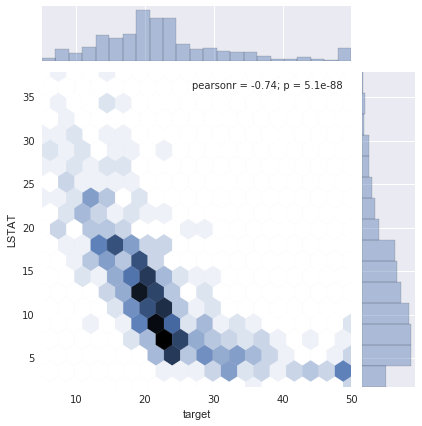

In [181]:
sns.jointplot(df['target'], df['LSTAT'], kind='hex')

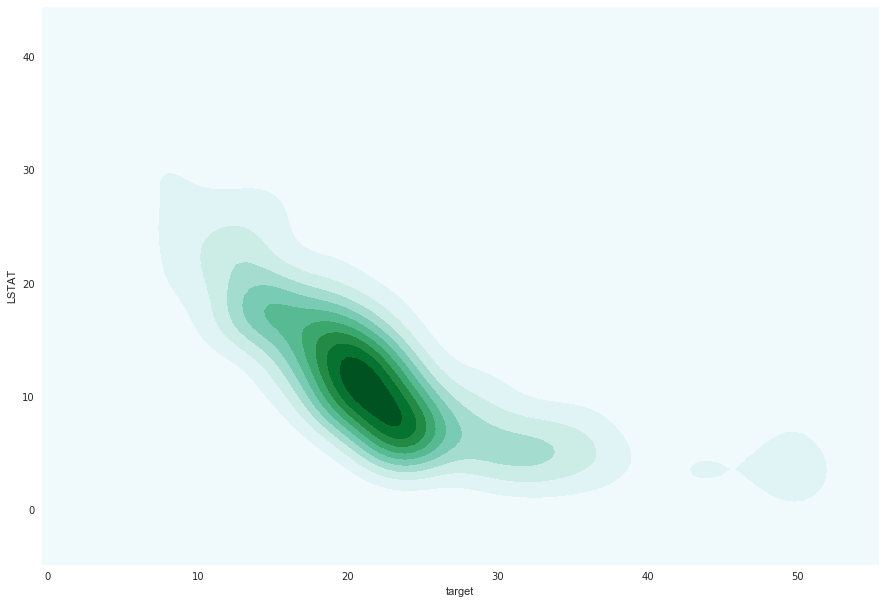

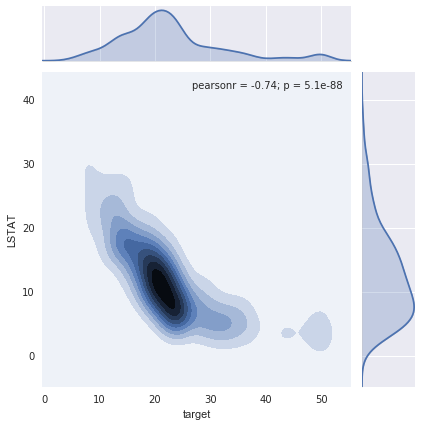

In [182]:
sns.kdeplot(df['target'], df['LSTAT'], shade=True)
# or 
sns.jointplot(df['target'], df['LSTAT'], kind='kde')

In [186]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.layouts import gridplot
output_notebook()

Loading BokehJS ...

In [187]:

from bokeh.plotting import figure, output_file, show

# prepare some data
aapl = np.array(df['target'])
aapl_dates = np.array(df['LSTAT'], dtype=np.datetime64)

window_size = 30
window = np.ones(window_size)/float(window_size)
aapl_avg = np.convolve(aapl, window, 'same')

# output to static HTML file
output_file("stocks.html", title="stocks.py example")

# create a new plot with a a datetime axis type
p = figure(width=800, height=350, x_axis_type="datetime")

# add renderers
p.circle(aapl_dates, aapl, size=4, color='darkgrey', alpha=0.2, legend='close')
p.line(aapl_dates, aapl_avg, color='navy', legend='avg')

# NEW: customize by setting attributes
p.title.text = "AAPL One-Month Average"
p.legend.location = "top_left"
p.grid.grid_line_alpha=0
p.xaxis.axis_label = 'Date'
p.yaxis.axis_label = 'Price'
p.ygrid.band_fill_color="olive"
p.ygrid.band_fill_alpha = 0.1

# show the results
show(p)

# Prepare the data for classification

In [ ]:
from sklearn import preprocessing
# for training data
dataset = data.values
X = dataset[:,0:9].astype(float)
Y = dataset[:,9]
features = preprocessing.scale(X)
target = Y

In [ ]:
# Make developement dataset for genrilization and final testing
from sklearn.cross_validation import train_test_split
# Extracting 20% testing data
X_train_feature, X_deploy, y_train_feature, y_deploy = train_test_split(
    features, target, test_size=0.20, random_state=0)
# Make training and validation data sets for building the models and choose the hyperparameters
X_train, X_test, y_train, y_test = train_test_split(
    X_train_feature, y_train_feature, test_size=0.20, random_state=0)
print 'Number of training examples',len(X_train)
print 'Number of validation examples',len(X_test)
print 'Number of testing examples',len(X_deploy)

## Preproccing

In [ ]:
from sklearn import preprocessing
# normalize the data attributes
X_train = preprocessing.normalize(X_train)
X_test = preprocessing.normalize(X_test)
X_deploy = preprocessing.normalize(X_deploy)
# standardize the data attributes
X_train = preprocessing.scale(X_train)
X_test = preprocessing.scale(X_test)
X_deploy = preprocessing.scale(X_deploy)

# Feature Selection

In [ ]:
from sklearn import metrics
from sklearn.ensemble import ExtraTreesClassifier
model = ExtraTreesClassifier()
model.fit(X_train, y_train)
# display the relative importance of each attribute
print(model.feature_importances_)

In [ ]:
# importabt of features according to random forest
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators = 15)
rf.fit(X, Y)
imp = rf.feature_importances_
names = data.columns

imp, names = zip(*sorted(zip(imp,names)))
plt.barh(range(len(names)), imp, align = 'center')
plt.yticks(range(len(names)), names)

plt.xlabel('Impotance of features')
plt.ylabel('features')
plt.title('Importance of each feature')
plt.show()

# Building classifiers

## KNN classifier
It turns out that k=5 is the best choose of k on the validation set

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=5)
#Training
start_time = time.time()
clf_neigh.fit(X_train, y_train)
print("The time for training KNN is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_neigh.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of Knn : \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])

## SVM classifier
### Linear SVM "LinearSVC"
It turns out that C=20 is the best on the validation set

In [ ]:
from sklearn.svm import LinearSVC
clf_svm_linear = LinearSVC(C=20.0)
#Training
start_time = time.time()
clf_svm_linear.fit(X_train, y_train)
print("The time for training SVM is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_svm_linear.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of Linear SVC: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])

###  SVM "SVC" with kernel='rbf' 
It turns out that C=5 is the best on the validation set


In [ ]:
from sklearn.svm import SVC
clf_svm = SVC(C=5.0, kernel='rbf')
#Training
start_time = time.time()
clf_svm.fit(X_train, y_train)
print("The time for training SVM is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_svm.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of SVC: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])

## Decsion Tree classifier
### DT with Gini impurity "gini", CART (Classification and Regression Trees)
It turns out that min_samples_split=2 is the best on the validation set

In [ ]:
# CART tree
from sklearn.tree import DecisionTreeClassifier
clf_dt = DecisionTreeClassifier(min_samples_split=2)
#Training
start_time = time.time()
clf_dt.fit(X_train, y_train)
print("The time for training Decision Tree is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of DT : \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


### DT with “entropy” for the information gain, C4.5 (aka J48 is an open source Java Weka) and C5.0
It turns out that min_samples_split=2 is the best on the validation set

In [ ]:
# Here I use C5.0 tree as its more accurate that C4.5 and more recent.
from sklearn.tree import DecisionTreeClassifier
clf_dt_IG = DecisionTreeClassifier(criterion='entropy', min_samples_split=2)
#Training
start_time = time.time()
clf_dt_IG.fit(X_train, y_train)
print("The time for training Decision Tree is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_IG.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of DT : \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


 Ensemble methods

## Bagging Method


### Bagging Method with Knn


Using Best KNN classifier fitted the data, each built on random subsets of 50% of the samples and 50% of the features.

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier
clf_dt_BGKN = BaggingClassifier(KNeighborsClassifier(n_neighbors=5),
                             max_samples=0.5, max_features=0.5)
start_time = time.time()
clf_dt_BGKN.fit(X_train, y_train)
print("The time for training Bagging Knn is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_BGKN.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of Bagging_knn: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


### Bagging Method with DT


Using Best DT with 'entropy', each built on random subsets of 50% of the samples and 50% of the features.

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
clf_dt_BGDT = BaggingClassifier(DecisionTreeClassifier(criterion='entropy', min_samples_split=2),
                             max_samples=0.5, max_features=0.5)
start_time = time.time()
clf_dt_BGDT.fit(X_train, y_train)
print("The time for training Bagging DT is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_BGDT.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of Bagging_DT: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


## Random Forest
DT with 'gini'

In [ ]:
from sklearn.ensemble import RandomForestClassifier
clf_dt_RF = RandomForestClassifier()
#Training
start_time = time.time()
clf_dt_RF.fit(X_train, y_train)
print("The time for training Decision Tree is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_RF.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of RF : \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


### Ada Boost
DT with 'gini'

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
clf_dt_AD = AdaBoostClassifier()
#Training
start_time = time.time()
clf_dt_AD.fit(X_train, y_train)
print("The time for training Decision Tree is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_AD.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of Ada boost : \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


## Naive Bayes methods

In [ ]:
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#Training
start_time = time.time()
clf_NB.fit(X_train, y_train)
print("The time for training Naive Bayes is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_NB.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of NB: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


## Linear Discriminant Analysis classifier

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
clf_dt_LDA = LinearDiscriminantAnalysis()
#Training
start_time = time.time()
clf_dt_LDA.fit(X_train, y_train)
print("The time for training Decision Tree is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_LDA.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of LDA: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


## Quadratic Discriminant Analysis classifier

In [ ]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
clf_dt_QDA = QuadraticDiscriminantAnalysis()
#Training
start_time = time.time()
clf_dt_QDA.fit(X_train, y_train)
print("The time for training Decision Tree is  %s seconds " % (time.time() - start_time))

# Make a prediction
y_pred = clf_dt_QDA.predict(X_test)
print "\n==================================================================="
print "The accuracy on validation dataset of QDA : \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])

## Neural Networks  classifier

In [ ]:
import seaborn as sns
import numpy as np
from sklearn.cross_validation import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.regularizers import l2

from keras.utils import np_utils

labelsTrain = np_utils.to_categorical(y_train)
labelsTest = np_utils.to_categorical(y_test)                                              
model = Sequential()
model.add(Dense(35,
                input_shape=(9,), 
                activation="relu",
                W_regularizer=l2(0.001)))
#model.add(Dropout(0.5))
model.add(Dense(8, activation="softmax"))

model.compile(loss='categorical_crossentropy',
              metrics=['accuracy'],
              optimizer='adam')
# Actual modelling
start_time = time.time()
model.fit(X_train, labelsTrain, verbose=0, batch_size=100, nb_epoch=100)
print("The time for training NN is  %s seconds " % (time.time() - start_time))
score, accuracy = model.evaluate(X_test, labelsTest, batch_size=100, verbose=0)
print("Test fraction correct (NN-Score) = {:.2f}".format(score))
print("Test fraction correct (NN-Accuracy) = {:.2f}".format(accuracy))

In [ ]:
y_pred = model.predict_classes(X_test)
print "==================================================================="
print "The accuracy on validation dataset of Neural Network: \t", metrics.accuracy_score(y_test, y_pred)
print "==================================================================="
print metrics.classification_report(y_test, y_pred, target_names=['1' , '2' , '3' , '5' , '6' , '7'])


In [ ]:
path = './glass/'
sys.path.append("./glass")
model.save_weights('glassModelbest.hdf5',overwrite=True)

In [ ]:
np.save('./glass/X_train', X_train)
np.save('./glass/y_train', y_train)
np.save('./glass/X_test', X_test)
np.save('./glass/y_test', y_test)
np.save('./glass/X_deploy', X_deploy)
np.save('./glass/y_deploy', y_deploy)